EN ESTE NOTEBOOK TRABAJEREMOS PROCESAMIENTO DE IMAGENES

In [1]:
%pip install -q scikit-image

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
from skimage import io, exposure, color, metrics
from skimage.measure import shannon_entropy
from skimage.filters import gaussian
import matplotlib.pyplot as plt
import numpy as np
import sys
import os

In [38]:
from skimage import io, exposure, color, metrics
from skimage.measure import shannon_entropy
from skimage.filters import gaussian
import matplotlib.pyplot as plt
import numpy as np
import sys
import os

def load_image(path, to_gray=False):
    """
    Carga una imagen y, si to_gray=True, la convierte a escala de grises [0,1].
    En otro caso devuelve la imagen (color o gris) normalizada en [0,1].
    """
    img = io.imread(path).astype(np.float64) / 255.0
    if to_gray and img.ndim == 3:
        img = color.rgb2gray(img)
    return img

def negative(img):
    return 1.0 - img

def log_transform(img, gain=1.0):
    return exposure.adjust_log(img, gain=gain)

def power_law(img, gamma=1.0):
    return exposure.adjust_gamma(img, gamma=gamma)

def hist_equalization(img):
    """Ecualización global de histograma; canal por canal si es color."""
    if img.ndim == 3:
        out = np.zeros_like(img)
        for c in range(img.shape[2]):
            out[...,c] = exposure.equalize_hist(img[...,c])
        return out
    else:
        return exposure.equalize_hist(img)

def detail_enhance_subtraction(img, sigma=1.0, amount=1.0):
    """
    Realce de detalles: img + amount*(img - gaussian(img)).
    Usa channel_axis para manejo de color.
    """
    if img.ndim == 3:
        blurred = gaussian(img, sigma=sigma, preserve_range=True, channel_axis=-1)
    else:
        blurred = gaussian(img, sigma=sigma, preserve_range=True)
    detail = img - blurred
    enhanced = img + amount * detail
    return np.clip(enhanced, 0, 1)

def noise_reduction_average(img, sigma=2.0):
    """Reducción de ruido mediante desenfoque gaussiano."""
    if img.ndim == 3:
        return gaussian(img, sigma=sigma, preserve_range=True, channel_axis=-1)
    else:
        return gaussian(img, sigma=sigma, preserve_range=True)

def compute_metrics(orig, proc):
    """Calcula PSNR, SSIM y entropía (promedio en canales para color)."""
    psnr = metrics.peak_signal_noise_ratio(orig, proc, data_range=1)
    if orig.ndim == 3:
        ssim = metrics.structural_similarity(orig, proc, data_range=1, channel_axis=-1)
        ent = np.mean([shannon_entropy((proc[...,c]*255).astype(np.uint8))
                       for c in range(proc.shape[2])])
    else:
        ssim = metrics.structural_similarity(orig, proc, data_range=1)
        ent = shannon_entropy((proc * 255).astype(np.uint8))
    return psnr, ssim, ent

def process_images(image_paths, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    for idx, path in enumerate(image_paths):
        # Las dos primeras imágenes → color; las otras dos → gris
        to_gray = (idx >= 2)
        img = load_image(path, to_gray=to_gray)
        base = os.path.splitext(os.path.basename(path))[0]

        methods = {
            'negative': negative(img),
            'log':       log_transform(img, gain=10.0),
            'power_0.3': power_law(img, gamma=0.5),
            'power_1.3': power_law(img, gamma=1.3),
            'hist_eq':   hist_equalization(img),
            'detail':    detail_enhance_subtraction(img, sigma=1.0, amount=1.0),
            'denoise':   noise_reduction_average(img, sigma=2.0)
        }

        # Guardar y medir
        metrics_summary = {}
        for name, proc in methods.items():
            out_img = (proc * 255).astype(np.uint8)
            out_path = os.path.join(output_dir, f"{base}_{name}.png")
            io.imsave(out_path, out_img)
            metrics_summary[name] = compute_metrics(img, proc)

        n_rows, n_cols = 4, 2
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(30, 30))
        axes = axes.flatten()

        # Lista ordenada de todas las imágenes a mostrar: primero la original
        display_list = [('Original', img)] + list(methods.items())

        for ax, (name, proc) in zip(axes, display_list):
            cmap = 'gray' if proc.ndim == 2 else None
            ax.imshow(proc, cmap=cmap)
            ax.set_title(name, fontsize=14)
            ax.axis('off')

        # Desactivar cualquier eje sobrante
        for ax in axes[len(display_list):]:
            ax.axis('off')

        plt.tight_layout(pad=2)
        plt.suptitle(f"Comparativo de técnicas: {base}", fontsize=18, y=1.02)
        plt.show()

        # Imprimir métricas
        print(f"=== Métricas para {base} ===")
        for name, (psnr, ssim, ent) in metrics_summary.items():
            print(f"{name:12s} → PSNR: {psnr:.2f}, SSIM: {ssim:.3f}, Entropía: {ent:.2f}")
        print()



c:\Users\simon\AppData\Local\Programs\Python\Python312\Lib\site-packages\skimage\_shared\utils.py:328: UserWarning: ./resultados_imagenes_procesadas\1003_negative.png is a low contrast image
  return func(*args, **kwargs)
c:\Users\simon\AppData\Local\Programs\Python\Python312\Lib\site-packages\skimage\_shared\utils.py:328: UserWarning: ./resultados_imagenes_procesadas\1003_power_1.3.png is a low contrast image
  return func(*args, **kwargs)
c:\Users\simon\AppData\Local\Programs\Python\Python312\Lib\site-packages\skimage\_shared\utils.py:328: UserWarning: ./resultados_imagenes_procesadas\1003_detail.png is a low contrast image
  return func(*args, **kwargs)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..10.0].


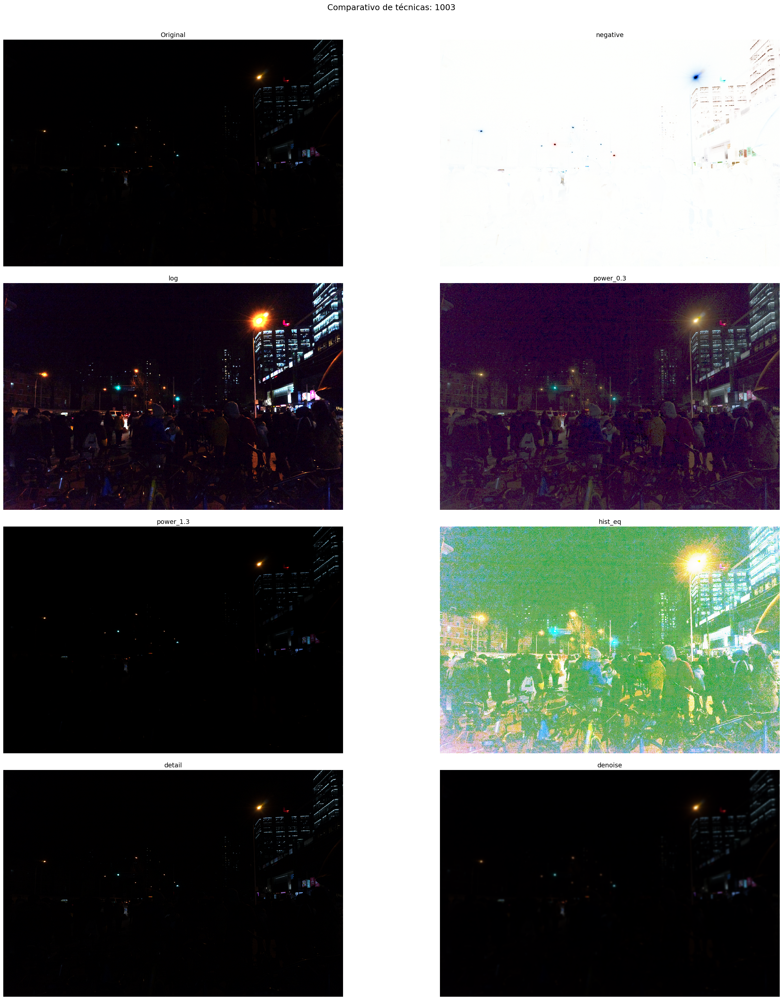

=== Métricas para 1003 ===
negative     → PSNR: 0.11, SSIM: 0.002, Entropía: 1.70
log          → PSNR: 8.65, SSIM: 0.208, Entropía: 1.70
power_0.3    → PSNR: 14.83, SSIM: 0.078, Entropía: 1.70
power_1.3    → PSNR: 40.62, SSIM: 0.898, Entropía: 0.50
hist_eq      → PSNR: 4.29, SSIM: 0.005, Entropía: 1.62
detail       → PSNR: 40.31, SSIM: 0.994, Entropía: 1.83
denoise      → PSNR: 34.50, SSIM: 0.972, Entropía: 1.59



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..10.0].


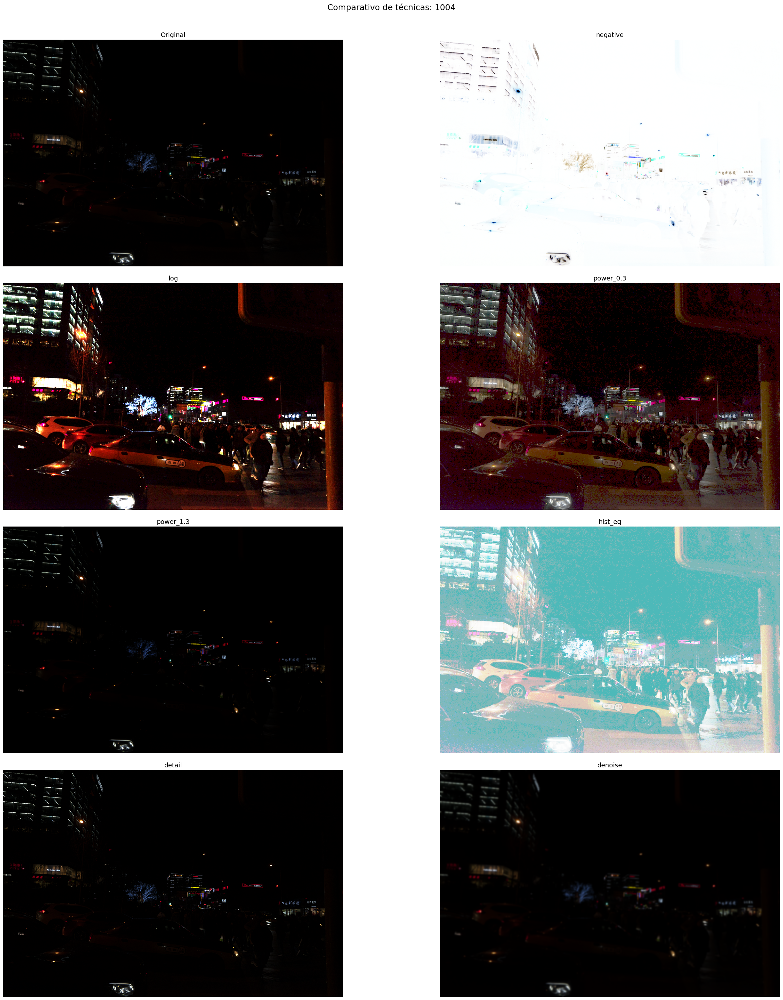

=== Métricas para 1004 ===
negative     → PSNR: 0.13, SSIM: -0.009, Entropía: 2.03
log          → PSNR: 5.32, SSIM: 0.463, Entropía: 2.02
power_0.3    → PSNR: 16.23, SSIM: 0.334, Entropía: 2.03
power_1.3    → PSNR: 37.91, SSIM: 0.928, Entropía: 0.87
hist_eq      → PSNR: 3.08, SSIM: 0.010, Entropía: 1.92
detail       → PSNR: 37.71, SSIM: 0.991, Entropía: 1.82
denoise      → PSNR: 31.43, SSIM: 0.954, Entropía: 1.90



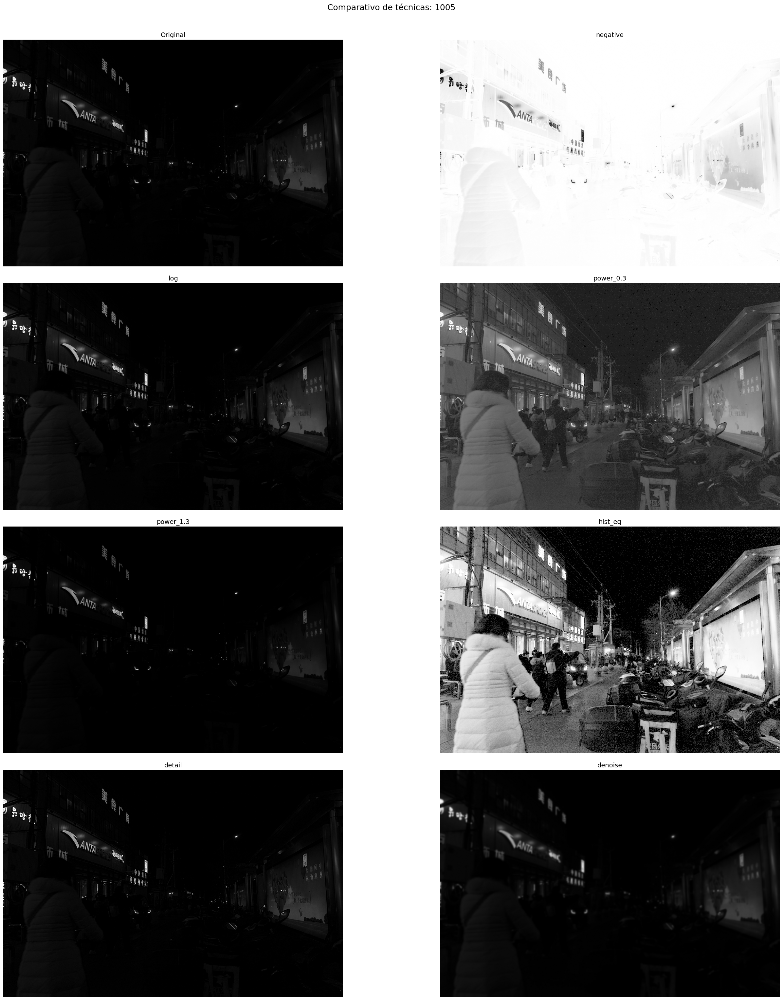

=== Métricas para 1005 ===
negative     → PSNR: 0.40, SSIM: 0.014, Entropía: 3.78
log          → PSNR: 2.69, SSIM: 0.111, Entropía: 6.22
power_0.3    → PSNR: 11.97, SSIM: 0.102, Entropía: 5.69
power_1.3    → PSNR: 33.31, SSIM: 0.821, Entropía: 2.37
hist_eq      → PSNR: 4.76, SSIM: 0.039, Entropía: 5.33
detail       → PSNR: 39.48, SSIM: 0.991, Entropía: 3.70
denoise      → PSNR: 33.01, SSIM: 0.962, Entropía: 3.80



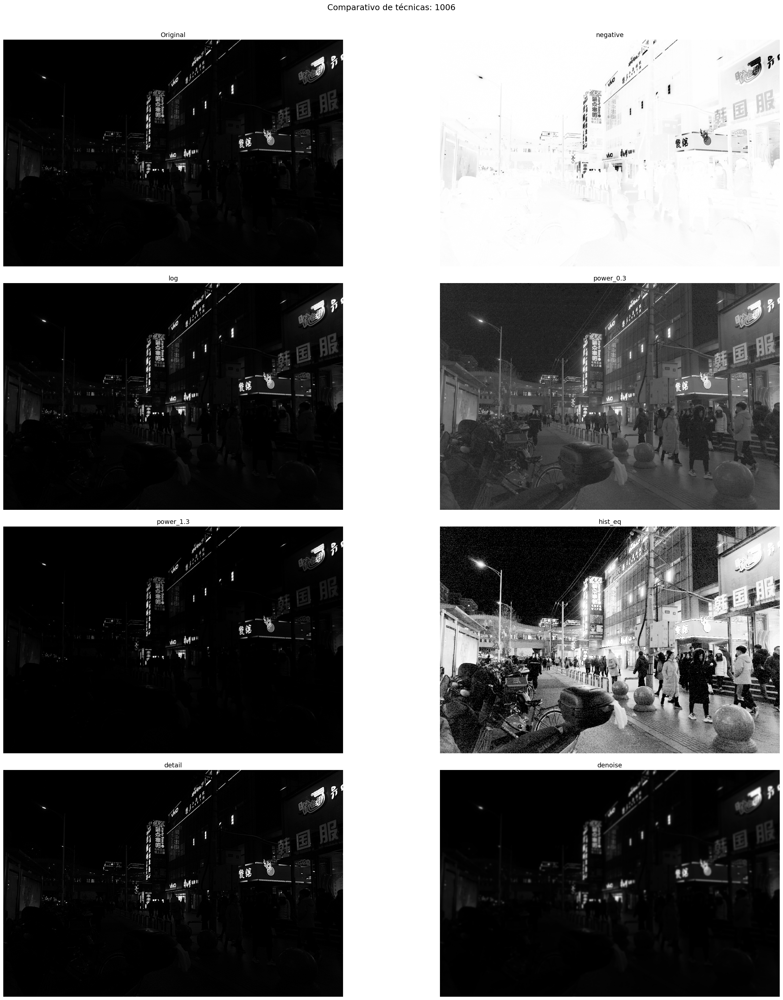

=== Métricas para 1006 ===
negative     → PSNR: 0.37, SSIM: -0.011, Entropía: 3.75
log          → PSNR: 0.50, SSIM: 0.086, Entropía: 6.36
power_0.3    → PSNR: 12.10, SSIM: 0.102, Entropía: 5.82
power_1.3    → PSNR: 33.84, SSIM: 0.805, Entropía: 2.25
hist_eq      → PSNR: 4.80, SSIM: 0.031, Entropía: 5.68
detail       → PSNR: 34.75, SSIM: 0.986, Entropía: 3.63
denoise      → PSNR: 28.22, SSIM: 0.931, Entropía: 3.85



In [37]:
input_dir  = "./Imagenes"
output_dir = "./resultados_imagenes_procesadas"

image_files = [os.path.join(input_dir, f"100{i}.png") for i in range(3,7)]
process_images(image_files, output_dir)

In [39]:
import cv2
import numpy as np
import os
import sys

def load_image(path, to_gray=False):
    """
    Lee una imagen con OpenCV.
    Si to_gray=True, la convierte a escala de grises.
    """
    img = cv2.imread(path, cv2.IMREAD_COLOR)
    if to_gray:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img

def negative(img):
    """Imagen negativa."""
    return 255 - img

def log_transform(img):
    """Transformación logarítmica."""
    img_float = img.astype(np.float32)
    c = 255 / np.log(1 + np.max(img_float))
    log_img = c * np.log(1 + img_float)
    return np.uint8(np.clip(log_img, 0, 255))

def power_law(img, gamma):
    """Ley de potencia (corrección gamma)."""
    img_norm = img.astype(np.float32) / 255.0
    power = np.power(img_norm, gamma)
    return np.uint8(np.clip(power * 255, 0, 255))

def hist_equalization(img):
    """Ecualización de histograma global."""
    if img.ndim == 2:
        return cv2.equalizeHist(img)
    # para color: ecualiza canal Y en YCrCb
    ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    ycrcb[:, :, 0] = cv2.equalizeHist(ycrcb[:, :, 0])
    return cv2.cvtColor(ycrcb, cv2.COLOR_YCrCb2BGR)

def detail_enhance_subtraction(img, sigma=1.0, amount=1.0):
    """
    Realce de detalles: img + amount*(img - blur).
    Blur con Gaussian filter.
    """
    blur = cv2.GaussianBlur(img, (0, 0), sigmaX=sigma, sigmaY=sigma)
    detail = cv2.subtract(img, blur)
    return cv2.addWeighted(img, 1.0, detail, amount, 0)

def noise_reduction_average(img, ksize=5):
    """Eliminación de ruido mediante filtro de promediado."""
    return cv2.blur(img, (ksize, ksize))

def process_images(image_paths, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    for idx, path in enumerate(image_paths):
        # Primeras 2 en color, últimas 2 en gris
        to_gray = (idx >= 2)
        img = load_image(path, to_gray=to_gray)
        base = os.path.splitext(os.path.basename(path))[0]

        methods = {
            'negative': negative(img),
            'log':       log_transform(img),
            'power_0.5': power_law(img, 0.5),
            'power_2.0': power_law(img, 2.0),
            'hist_eq':   hist_equalization(img),
            'detail':    detail_enhance_subtraction(img, sigma=1.0, amount=1.0),
            'denoise':   noise_reduction_average(img, ksize=5)
        }

        # Guarda cada resultado
        for name, proc in methods.items():
            out_path = os.path.join(output_dir, f"{base}_{name}.png")
            cv2.imwrite(out_path, proc)

        # Construye mosaico 4×2 (8 imágenes) con celdas de 400×400 px
        display = [('Original', img)] + list(methods.items())
        tiles = []
        for name, proc in display:
            # Asegura BGR uint8
            if proc.ndim == 2:
                tile = cv2.cvtColor(proc, cv2.COLOR_GRAY2BGR)
            else:
                tile = proc
            tile = cv2.resize(tile, (400, 400))
            cv2.putText(tile, name, (10, 25),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.8,
                        (0, 255, 0), 2, cv2.LINE_AA)
            tiles.append(tile)

        row1 = cv2.hconcat(tiles[0:4])
        row2 = cv2.hconcat(tiles[4:8])
        mosaic = cv2.vconcat([row1, row2])

        # Muestra y guarda el mosaico
        win = f"Comparativo {base}"
        cv2.namedWindow(win, cv2.WINDOW_NORMAL)
        cv2.imshow(win, mosaic)
        cv2.waitKey(0)
        cv2.destroyWindow(win)
        cv2.imwrite(os.path.join(output_dir, f"{base}_mosaic.png"), mosaic)




In [ ]:

inp, outp = "./imagenes", "./enhanced_results"
image_files = [os.path.join(input_dir, f"100{i}.png") for i in range(3,7)]
process_images(image_files, outp)

Procesando ./Imagenes\1003.png


c:\Users\simon\AppData\Local\Programs\Python\Python312\Lib\site-packages\skimage\_shared\utils.py:328: UserWarning: ./resultados_imagenes_procesadas\1003_power_2.0.png is a low contrast image
  return func(*args, **kwargs)


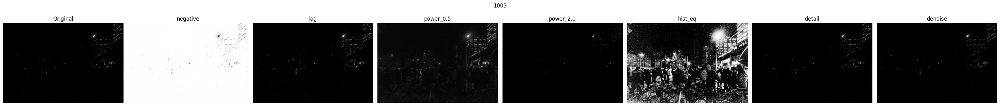

=== Métricas para 1003 ===
negative     → PSNR: 0.088736807634119, SSIM: -0.0007383765141543321, Entropía: 1.567956043227764
log          → PSNR: 43.13861286368802, SSIM: 0.9853495041118812, Entropía: 1.7478019750410378
power_0.5    → PSNR: 24.7547291135363, SSIM: 0.14700601491984863, Entropía: 3.311943925810465
power_2.0    → PSNR: 34.815821771091166, SSIM: 0.8812516322782912, Entropía: 0.17566736140380335
hist_eq      → PSNR: 2.6890384774702336, SSIM: 0.004933018986197995, Entropía: 2.400264828044974
detail       → PSNR: 40.35377469863897, SSIM: 0.9945289122532779, Entropía: 1.507606415318113
denoise      → PSNR: 34.738394588882414, SSIM: 0.9730051034734054, Entropía: 1.4006761837247608

Procesando ./Imagenes\1004.png


c:\Users\simon\AppData\Local\Programs\Python\Python312\Lib\site-packages\skimage\_shared\utils.py:328: UserWarning: ./resultados_imagenes_procesadas\1004_power_2.0.png is a low contrast image
  return func(*args, **kwargs)


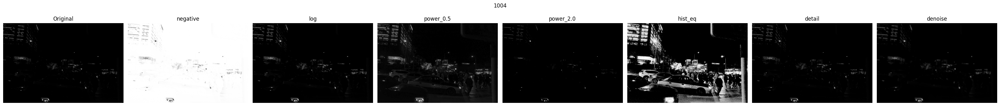

=== Métricas para 1004 ===
negative     → PSNR: 0.1282220419460899, SSIM: -0.008963740270956729, Entropía: 2.449225045454775
log          → PSNR: 40.04946610275708, SSIM: 0.9839978246325357, Entropía: 1.9918686182535026
power_0.5    → PSNR: 23.902302129701386, SSIM: 0.34655204176576365, Entropía: 3.5736093471157524
power_2.0    → PSNR: 31.705592884088283, SSIM: 0.8478915640921079, Entropía: 0.346373162337007
hist_eq      → PSNR: 2.3658565116405113, SSIM: 0.009976905854558193, Entropía: 2.416952371414055
detail       → PSNR: 37.873661349539915, SSIM: 0.9920026569138973, Entropía: 1.6700289189792423
denoise      → PSNR: 31.54712761881072, SSIM: 0.9544504713968949, Entropía: 1.9247137925477487

Procesando ./Imagenes\1005.png


c:\Users\simon\AppData\Local\Programs\Python\Python312\Lib\site-packages\skimage\_shared\utils.py:445: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


ValueError: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.

In [24]:
""" if len(sys.argv) >= 3:
    input_dir, output_dir = sys.argv[1], sys.argv[2]
else: """
input_dir  = "./Imagenes"
output_dir = "./resultados_imagenes_procesadas"

# Selecciona las cuatro imágenes
# image_files = [os.path.join(input_dir, f"face{i}.png") for i in range(1,5)]
image_files = [os.path.join(input_dir, f"100{i}.png") for i in range(3,7)]
for path in image_files:
    print(f"Procesando {path}")
    
    process_image(path, output_dir)

In [ ]:
from skimage import io, exposure, img_as_float
import matplotlib.pyplot as plt

# Cargar imagen (puede ser en escala de grises o color)
imagen = io.imread('./1004.png', as_gray=True)  # Usa as_gray=False para color
imagen = img_as_float(imagen)  # Asegura que la imagen esté en float

# Aplicar rescale_intensity
imagen_rescalada = exposure.rescale_intensity(imagen, in_range='image', out_range=(0, 1))

# Aplicar equalize_hist
imagen_ecualizada = exposure.equalize_hist(imagen)

# Visualizar resultados
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(imagen, cmap='gray')
axs[0].set_title('Original')
axs[0].axis('off')

axs[1].imshow(imagen_rescalada, cmap='gray')
axs[1].set_title('Rescale Intensity')
axs[1].axis('off')

axs[2].imshow(imagen_ecualizada, cmap='gray')
axs[2].set_title('Equalize Hist')
axs[2].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import os
import cv2
import numpy as np
from skimage import exposure, metrics, measure

# ----------------------------------------
# 1. Helper functions for enhancement
# ----------------------------------------

def contrast_stretch(img: np.ndarray) -> np.ndarray:
    img_min, img_max = img.min(), img.max()
    stretched = ((img.astype(np.float32) - img_min) / (img_max - img_min) * 255.0)
    return np.clip(stretched, 0, 255).astype(np.uint8)

def gamma_correction(img: np.ndarray, gamma: float) -> np.ndarray:
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255
                      for i in np.arange(256)]).astype("uint8")
    return cv2.LUT(img, table)

def histogram_equalization(img: np.ndarray) -> np.ndarray:
    return cv2.equalizeHist(img)

def clahe_equalization(img: np.ndarray, clip_limit=2.0, tile_grid_size=(8,8)) -> np.ndarray:
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    return clahe.apply(img)

def smooth_image(img: np.ndarray, ksize=(5,5), sigma=0) -> np.ndarray:
    return cv2.GaussianBlur(img, ksize, sigma)

def arithmetic_combine(img1: np.ndarray, img2: np.ndarray, alpha=1.2, beta=-0.2) -> np.ndarray:
    combined = cv2.addWeighted(img1.astype(np.float32), alpha,
                               img2.astype(np.float32), beta, 0)
    return np.clip(combined, 0, 255).astype(np.uint8)

# ----------------------------------------
# 2. Metrics
# ----------------------------------------

def compute_metrics(orig: np.ndarray, proc: np.ndarray) -> dict:
    psnr = metrics.peak_signal_noise_ratio(orig, proc, data_range=255)
    ssim = metrics.structural_similarity(orig, proc, data_range=255)
    entropy = measure.shannon_entropy(proc)
    return {'PSNR': psnr, 'SSIM': ssim, 'Entropy': entropy}

# ----------------------------------------
# 3. Comparación en escala de grises
# ----------------------------------------

def compare_grayscale(path1: str, path2: str, out_path: str) -> None:
    """Carga dos imágenes en gris y guarda una comparación lado a lado."""
    img1 = cv2.imread(path1, cv2.IMREAD_GRAYSCALE)
    img2 = cv2.imread(path2, cv2.IMREAD_GRAYSCALE)
    # Asegurar mismo tamaño
    h = min(img1.shape[0], img2.shape[0])
    w = min(img1.shape[1], img2.shape[1])
    img1_resized = cv2.resize(img1, (w, h))
    img2_resized = cv2.resize(img2, (w, h))
    comparison = np.hstack((img1_resized, img2_resized))
    cv2.imwrite(out_path, comparison)

# ----------------------------------------
# 4. Main pipeline
# ----------------------------------------

def process_image(path: str, output_dir: str) -> dict:
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    name = os.path.splitext(os.path.basename(path))[0]
    os.makedirs(output_dir, exist_ok=True)

    # Prefiltro
    img_smooth = smooth_image(img)

    # Aplicación de técnicas
    enhancements = {
        'stretch': contrast_stretch(img),
        'gamma_0.5': gamma_correction(img, 0.5),
        'gamma_2.0': gamma_correction(img, 2.0),
        'hist_eq': histogram_equalization(img),
        'clahe': clahe_equalization(img),
        'arith_sum': arithmetic_combine(img, img_smooth)
    }

    # Guardar y medir
    metrics_dict = {}
    paths = {}
    for key, proc in enhancements.items():
        fn = f"{name}_{key}.png"
        out = os.path.join(output_dir, fn)
        cv2.imwrite(out, proc)
        paths[key] = out
        metrics_dict[key] = compute_metrics(img, proc)

    # Comparar en gris dos métodos (ajusta las claves si quieres otros)
    compare_pairs = [('stretch', 'hist_eq')]
    for m1, m2 in compare_pairs:
        out_cmp = os.path.join(output_dir, f"{name}_cmp_{m1}_vs_{m2}.png")
        compare_grayscale(paths[m1], paths[m2], out_cmp)

    return {
        'metrics': metrics_dict,
        'outputs': paths,
        'comparisons': {f"{m1}_vs_{m2}": os.path.join(output_dir, f"{name}_cmp_{m1}_vs_{m2}.png")
                        for m1, m2 in compare_pairs}
    }

if __name__ == "__main__":
    image_paths = [
        "./images/face1.png",
        "./images/face2.png",
        "./images/face3.png",
        "./images/face4.png"
    ]
    output_directory = "./enhanced_results"

    all_results = {}
    for img_path in image_paths:
        res = process_image(img_path, output_directory)
        all_results[os.path.basename(img_path)] = res

    # Resumen de métricas
    for img_name, res in all_results.items():
        print(f"Resultados para {img_name}:")
        for method, m in res['metrics'].items():
            print(f"  {method:12s}→ PSNR: {m['PSNR']:.2f}, SSIM: {m['SSIM']:.3f}, Entropía: {m['Entropy']:.2f}")
        # Rutas de comparación
        for cmp_name, cmp_path in res['comparisons'].items():
            print(f"  Comparación ({cmp_name}): {cmp_path}")
        print()


In [2]:
from skimage import exposure, io
import numpy as np

import matplotlib.pyplot as plt



In [4]:

# Cargar la imagen
image = io.imread('1004.png')


**TRANSFORMACION CON equalize_hist() Y rescale_intensity()**

In [5]:

# Aplicar ecualización de histograma
equalized_image = exposure.equalize_hist(image)


/usr/local/lib/python3.11/dist-packages/skimage/_shared/utils.py:445: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


In [10]:

# Aplicar rescalado de intensidad
rescaled_image = exposure.rescale_intensity(equalized_image, in_range='image', out_range=(0, 255))
# Convertir la imagen rescalada a uint8 para guardarla correctamente
rescaled_image_uint8 = (rescaled_image * 255).astype('uint8')



In [11]:


# Guardar la imagen procesada
io.imsave('imagen_procesada.jpg', rescaled_image_uint8)



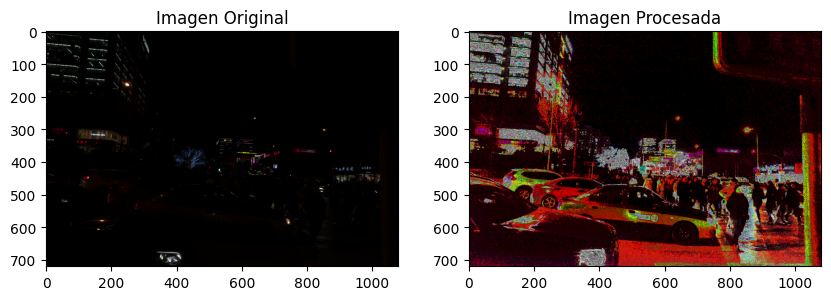

In [13]:

#Mostrar la imagen original y la imagen procesada
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image, cmap='gray')
axes[0].set_title('Imagen Original')
axes[1].imshow(rescaled_image_uint8, cmap='gray')
axes[1].set_title('Imagen Procesada')
plt.show()


**TRANSFORMACION POR SUMA Y MULTIPLICACION**

In [16]:

# Número de veces que se sumará la imagen
n = 10

# Sumar la imagen n veces
summed_image = np.clip(image * n, 0, 255).astype('uint8')


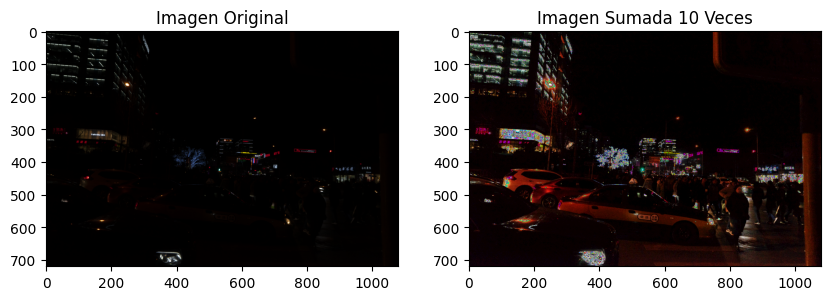

In [17]:

# Mostrar la imagen original y la imagen sumada
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image, cmap='gray')
axes[0].set_title('Imagen Original')
axes[1].imshow(summed_image, cmap='gray')
axes[1].set_title(f'Imagen Sumada {n} Veces')
plt.show()


In [21]:

# Valor escalar para multiplicar la imagen
scalar = 10

# Multiplicar la imagen por el valor escalar
multiplied_image = np.clip(image * scalar, 0, 255).astype('uint8')


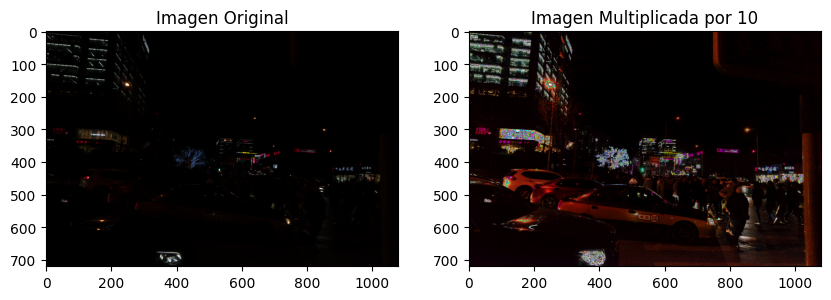

In [22]:

# Mostrar la imagen original y la imagen multiplicada
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image, cmap='gray')
axes[0].set_title('Imagen Original')
axes[1].imshow(multiplied_image, cmap='gray')
axes[1].set_title(f'Imagen Multiplicada por {scalar}')
plt.show()


**TRANSFORMACION EXPONENCIAL**

In [46]:

# Aplicar transformación exponencial
exponential_image1 = np.clip(np.exp(image / 255.0) * 255, 0, 255).astype('uint8')

# Aplicar transformación exponencial
exponential_image2 = np.clip(np.exp(image / 255.0) - 1, 0, 125).astype('uint8')

# Aplicar transformación exponencial
exponential_image3 = np.clip(np.exp(image / 255.0) * 255 / np.exp(1), 0, 255).astype('uint8')



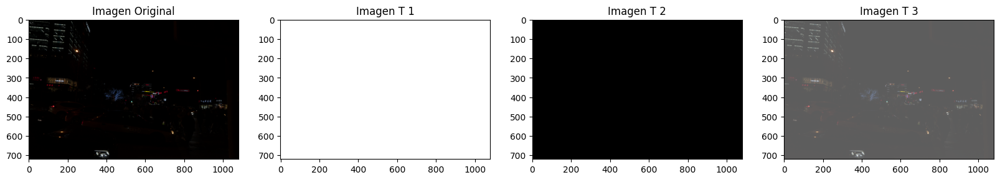

In [49]:

# Mostrar la imagen original y la imagen transformada exponencialmente
fig, axes = plt.subplots(1, 4, figsize=(20, 8))
axes[0].imshow(image, cmap='gray')
axes[0].set_title('Imagen Original')
axes[1].imshow(exponential_image1, cmap='gray')
axes[1].set_title('Imagen T 1')
axes[2].imshow(exponential_image2, cmap='gray')
axes[2].set_title('Imagen T 2')
axes[3].imshow(exponential_image3, cmap='gray')
axes[3].set_title('Imagen T 3')
plt.show()
